# Preparing Data

In [1]:
# This Python 3 environment comes with many helpful analytics libraries installed
# It is defined by the kaggle/python Docker image: https://github.com/kaggle/docker-python
# For example, here's several helpful packages to load
# !pip install torchmetrics
# !pip install torchmetrics[detection]
# !pip install torchvision
# !pip install pytorch-msssim
import numpy as np # linear algebra
import pandas as pd # data processing, CSV file I/O (e.g. pd.read_csv)
from matplotlib import pyplot as plt
import pandas as pd
import torch
import torchvision
from collections import OrderedDict
!pip install pytorch-msssim
from pytorch_msssim import ssim, ms_ssim, SSIM, MS_SSIM
# !pip install torchviz
# !pip install scikit-image
# # !pip install onnxscript
# !pip install onnxruntime

# !pip install 'ray[tune]'
# !pip install -U 'ray[default]'
# !pip install -U ipywidgets
# !pip install optuna
# !pip install pycocotools

  Obtaining dependency information for pytorch-msssim from https://files.pythonhosted.org/packages/e2/8c/856047f955acc30179e9255fdc488059ca22f0938519523d53494f7cfee8/pytorch_msssim-1.0.0-py3-none-any.whl.metadata


In [2]:
import os
train_labels = []
val_labels = []
def get_label(name):
    if name == "cat":
        return 0
    if name == "dog":
        return 1
    if name == "wild":
        return 2
for dirname, _, filenames in os.walk('/kaggle/input/afhq/train'):
    for filename in filenames:
        train_labels.append([filename,get_label(dirname.split("/")[-1])])
for dirname, _, filenames in os.walk('/kaggle/input/afhq/val'):
    for filename in filenames:
        val_labels.append([filename,get_label(dirname.split("/")[-1])])
train_labels=pd.DataFrame(train_labels,columns=["path","label"])
val_labels=pd.DataFrame(val_labels,columns=["path","label"])

In [3]:
train_labels = train_labels.query("label == 0")

In [4]:
import  os
import pandas as pd
import torch
from torchvision.io import read_image
import torchvision
from scipy.interpolate import NearestNDInterpolator
from matplotlib import pyplot as plt
class DataSet(torch.utils.data.Dataset):
    def __init__(self, annotations_file, img_dir, transform=None):
        self.img_labels = annotations_file
        self.img_dir = img_dir
        self.transform = transform
        self.res = torchvision.transforms.Resize((128,128),antialias=True)
        print(annotations_file)
    def __len__(self):
        return len(self.img_labels)

    def __getitem__(self, idx):
        
        data = self.img_labels.iloc[idx]
        if(data["label"] == 0):
            image_x = torch.Tensor(torchvision.io.read_image(os.path.join(self.img_dir,"cat",data["path"])))
        elif(data["label"] == 1):
            image_x = torch.Tensor(torchvision.io.read_image(os.path.join(self.img_dir,"dog",data["path"])))
        elif(data["label"] == 2):
            image_x = torch.Tensor(torchvision.io.read_image(os.path.join(self.img_dir,"wild",data["path"])))
        if self.transform:
            tr_x = self.transform(image=image_x.numpy())
            image_x = torch.from_numpy(tr_x["image"])
            
        image_x = self.res(image_x)
        
        if(data["label"] == 0):
            yy = torch.Tensor([1,0,0])
        elif(data["label"] == 1):
            yy = torch.Tensor([0,1,0])
        else:
            yy = torch.Tensor([0,0,1])
        return 2.0*image_x/255.0 - 1.0,yy

/opt/conda/lib/python3.10/site-packages/scipy/__init__.py:146: UserWarning: A NumPy version >=1.16.5 and <1.23.0 is required for this version of SciPy (detected version 1.24.3
  warnings.warn(f"A NumPy version >={np_minversion} and <{np_maxversion}"


In [5]:
device = torch.device("cuda" if torch.cuda.is_available() else "cpu")

In [6]:
def collate(batch):
    final_images_x = []
    final_images_class = []
    for data in batch:
        final_images_x.append(data[0])
        final_images_class.append(data[1])
    return list(zip(final_images_x,final_images_class))

In [7]:
from torch.utils.data import DataLoader
train_dataset = DataSet(train_labels,"/kaggle/input/afhq/train")
vis_loader = DataLoader(train_dataset,shuffle=False,batch_size=4,collate_fn=collate)
X_train_loader = DataLoader(train_dataset,shuffle=True,batch_size=128)


                         path  label
9477   pixabay_cat_000354.jpg      0
9478   pixabay_cat_002763.jpg      0
9479   pixabay_cat_001283.jpg      0
9480   pixabay_cat_003423.jpg      0
9481    flickr_cat_000496.jpg      0
...                       ...    ...
14625  pixabay_cat_001478.jpg      0
14626  pixabay_cat_003285.jpg      0
14627  pixabay_cat_002348.jpg      0
14628  pixabay_cat_001441.jpg      0
14629  pixabay_cat_000922.jpg      0

[5153 rows x 2 columns]


In [8]:
def visualize():
    vis_iter = iter(vis_loader)
    data = next(vis_iter)
    for x,label in data:
        plt.subplots()
        plt.imshow(((x+1.0)*255.0/2.0).permute(1,2,0).int())
        print(label)

tensor([1., 0., 0.])
tensor([1., 0., 0.])
tensor([1., 0., 0.])
tensor([1., 0., 0.])


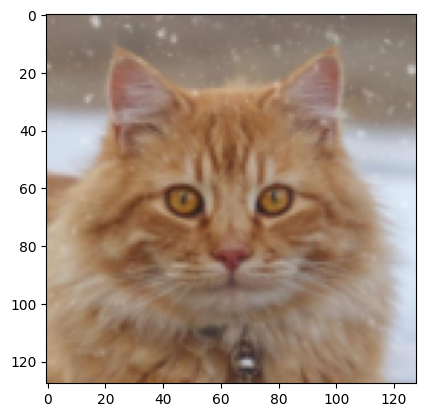

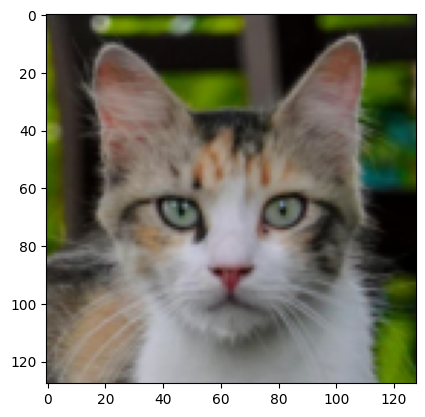

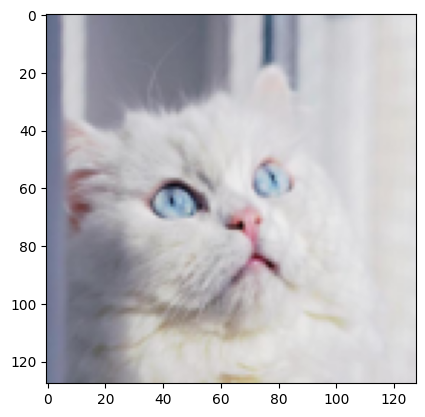

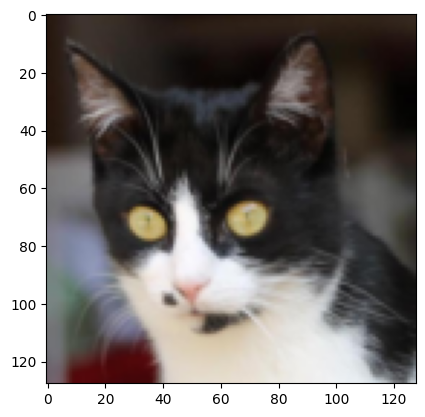

In [9]:
visualize()

# Preparing Model

In [10]:
Z_DIM = 64
BETA_1=0.5
CALIBRATION=0.93
LR=1e-3
GP_WEIGHT=0.00001

In [11]:
def weights_init(m):
    classname = m.__class__.__name__
    if classname.find('Conv') != -1:
        nn.init.normal_(m.weight.data, 0.0, 0.01)
    elif classname.find('BatchNorm') != -1:
        nn.init.normal_(m.weight.data, 1.0, 0.01)
        nn.init.constant_(m.bias.data, 0)

In [12]:
class Encoder(torch.nn.Module):
    def __init__(self):
        super().__init__()
        self.down_1 = torch.nn.Sequential(torch.nn.Conv2d(3,64,(3,3),padding="same"),torch.nn.Conv2d(64,128,(2,2),stride=2),torch.nn.BatchNorm2d(128),torch.nn.LeakyReLU(0.1))
        self.down_2 = torch.nn.Sequential(torch.nn.Conv2d(128,256,(2,2),padding="same"),torch.nn.Conv2d(256,256,(2,2),stride=2),torch.nn.BatchNorm2d(256),torch.nn.LeakyReLU(0.1))
        self.down_3 = torch.nn.Sequential(torch.nn.Conv2d(256,128,(2,2),padding="same"),torch.nn.Conv2d(128,32,(2,2),stride=2),torch.nn.BatchNorm2d(32),torch.nn.LeakyReLU(0.1))
        self.down_final = torch.nn.Sequential(torch.nn.Linear(16*16*32,2*Z_DIM,bias=True))
        self.finalRelu = torch.nn.ReLU()

    def forward(self, x):
#         x = self.base_1(x)
        x = self.down_1(x)
        x = self.down_2(x)
        x = self.down_3(x)

        x = x.view(-1,16*16*32)
        x = self.down_final(x)
        x = x.view(-1,2,Z_DIM)
        return torch.stack([x[:,0],self.finalRelu(x[:,1])])

    def string(self):
        return "xD"


In [13]:
torch.Tensor((1,2))

tensor([1., 2.])

In [14]:
# class Generator(torch.nn.Module):
#     def __init__(self,in_shape):
#         super().__init__()
# #         self.base_1 = torch.nn.Sequential(torch.nn.Linear(in_shape,128 * Z_FEATURES,bias=False),torch.nn.ReLU(),torch.nn.Linear(128 * Z_FEATURES,1024 * Z_FEATURES,bias=False),torch.nn.ReLU())
#         self.up_1 = torch.nn.Sequential(torch.nn.Conv2d(Z_FEATURES,128,(3,3),padding="same"),torch.nn.Conv2d(128,256,(3,3),padding="same"),torch.nn.BatchNorm2d(256),torch.nn.ReLU(),torch.nn.ConvTranspose2d(256,256,(2,2),stride=2))
#         self.up_2 = torch.nn.Sequential(torch.nn.Conv2d(256,256,(3,3),padding="same"),torch.nn.ReLU(),torch.nn.ConvTranspose2d(256,128,(2,2),stride=2),torch.nn.BatchNorm2d(128),torch.nn.ReLU(),torch.nn.ConvTranspose2d(128,64,(2,2),stride=2))
#         self.up_final = torch.nn.Sequential(torch.nn.Upsample((64,64),mode="bilinear"),torch.nn.Conv2d(64,3,(3,3),padding="same"),torch.nn.Tanh())
#     def forward(self, x):
# #         x = self.base_1(x)
#         x = x.view(-1,Z_FEATURES,int(np.sqrt(Z_DIM)),int(np.sqrt(Z_DIM)))
#         x = self.up_1(x)
#         x = self.up_2(x)
#         x = self.up_final(x)
#         return x

#     def string(self):
#         return "xD"


class Generator(torch.nn.Module):
    def __init__(self,in_shape):
        super().__init__()
        self.up = torch.nn.Linear(Z_DIM,256*128)
        self.up_1 = torch.nn.Sequential(torch.nn.Conv2d(128,256,(3,3),padding="same"),torch.nn.BatchNorm2d(256),torch.nn.ReLU(),torch.nn.ConvTranspose2d(256,256,(2,2),stride=2))
#         self.up_2 = torch.nn.Sequential(torch.nn.Conv2d(256,256,(3,3),padding="same"),torch.nn.ReLU(),torch.nn.ConvTranspose2d(256,128,(2,2),stride=2),torch.nn.BatchNorm2d(128),torch.nn.ReLU(),torch.nn.ConvTranspose2d(128,64,(2,2),stride=2))
        self.up_final = torch.nn.Sequential(torch.nn.ConvTranspose2d(256,256,(2,2),stride=2),torch.nn.ReLU(),torch.nn.Conv2d(256,64,(3,3),padding="same"),torch.nn.Conv2d(64,3,(3,3),padding="same"),torch.nn.Tanh(),torch.nn.Upsample((128,128),mode="bilinear"))
    def forward(self, u,sigmasq,noise):
#         x = self.base_1(x)
        
        x = u + sigmasq * noise
        x = self.up(x)

        x = x.view(-1,128,16,16)
        x = self.up_1(x)
#         x = self.up_2(x)
        x = self.up_final(x)

        return x

    def string(self):
        return "xD"


In [15]:
en = Encoder()
en.to(device)

Encoder(
  (down_1): Sequential(
    (0): Conv2d(3, 64, kernel_size=(3, 3), stride=(1, 1), padding=same)
    (1): Conv2d(64, 128, kernel_size=(2, 2), stride=(2, 2))
    (2): BatchNorm2d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (3): LeakyReLU(negative_slope=0.1)
  )
  (down_2): Sequential(
    (0): Conv2d(128, 256, kernel_size=(2, 2), stride=(1, 1), padding=same)
    (1): Conv2d(256, 256, kernel_size=(2, 2), stride=(2, 2))
    (2): BatchNorm2d(256, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (3): LeakyReLU(negative_slope=0.1)
  )
  (down_3): Sequential(
    (0): Conv2d(256, 128, kernel_size=(2, 2), stride=(1, 1), padding=same)
    (1): Conv2d(128, 32, kernel_size=(2, 2), stride=(2, 2))
    (2): BatchNorm2d(32, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (3): LeakyReLU(negative_slope=0.1)
  )
  (down_final): Sequential(
    (0): Linear(in_features=8192, out_features=128, bias=True)
  )
  (finalRelu): ReLU()
)

In [16]:
g = Generator(Z_DIM)
g.to(device)

Generator(
  (up): Linear(in_features=64, out_features=32768, bias=True)
  (up_1): Sequential(
    (0): Conv2d(128, 256, kernel_size=(3, 3), stride=(1, 1), padding=same)
    (1): BatchNorm2d(256, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU()
    (3): ConvTranspose2d(256, 256, kernel_size=(2, 2), stride=(2, 2))
  )
  (up_final): Sequential(
    (0): ConvTranspose2d(256, 256, kernel_size=(2, 2), stride=(2, 2))
    (1): ReLU()
    (2): Conv2d(256, 64, kernel_size=(3, 3), stride=(1, 1), padding=same)
    (3): Conv2d(64, 3, kernel_size=(3, 3), stride=(1, 1), padding=same)
    (4): Tanh()
    (5): Upsample(size=(128, 128), mode='bilinear')
  )
)

In [17]:
# x = torch.normal(0,torch.Tensor(np.array([0.1])).repeat(Z_DIM)).repeat(Z_FEATURES)
# fake=g(x.view(1,-1).to(device))
# d(fake).shape

In [18]:
# preOpt = torch.optim.Adam(d.parameters(), lr=LR)
# d_train_loss = torch.nn.BCELoss().to(device)
# for e in range(1):
    
#     tloss = 0


#     for bi,(x,labels) in enumerate(iter(X_train_loader)):
#         x = x.to(device)
        
#         # Train discriminator 
#         preOpt.zero_grad()
        
#         res=d(x)
#         loss = d_train_loss(res,labels.to(device))
#         loss.backward()
        
#         preOpt.step()
        
#         if(bi % 20 == 0):
#             print(loss)
        
#         with torch.no_grad():
#             tloss += loss
        
#     print(tloss)
        
    
        

In [19]:
# d.revert()
# d
# d.to(device)

# Training

/opt/conda/lib/python3.10/site-packages/torch/nn/modules/conv.py:459: UserWarning: Using padding='same' with even kernel lengths and odd dilation may require a zero-padded copy of the input be created (Triggered internally at /usr/local/src/pytorch/aten/src/ATen/native/Convolution.cpp:1003.)
  return F.conv2d(input, weight, bias, self.stride,


Epoch [0] Batch [40]  - [0.024225540459156036]


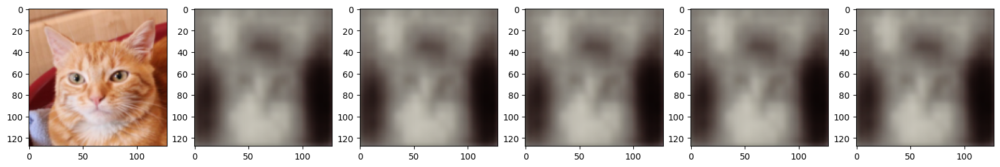

Epoch [0] - G : [3.144219160079956]
Epoch [1] Batch [40]  - [-0.003733128309249878]


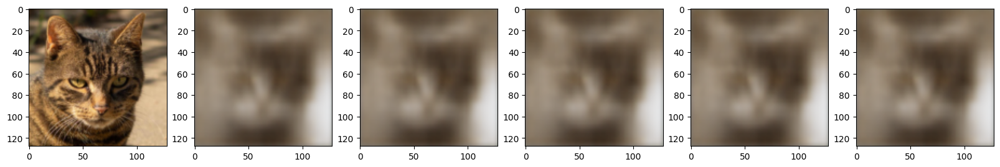

Epoch [1] - G : [0.14907965064048767]
Epoch [2] Batch [40]  - [-0.01532692089676857]


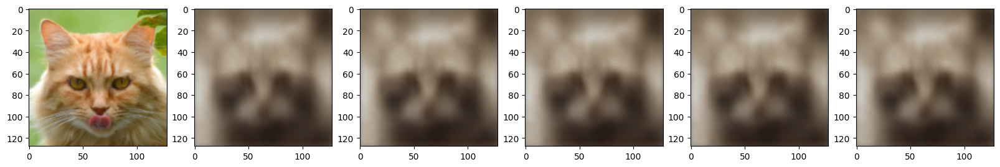

Epoch [2] - G : [-0.6382617354393005]
Epoch [3] Batch [40]  - [-0.03205997124314308]


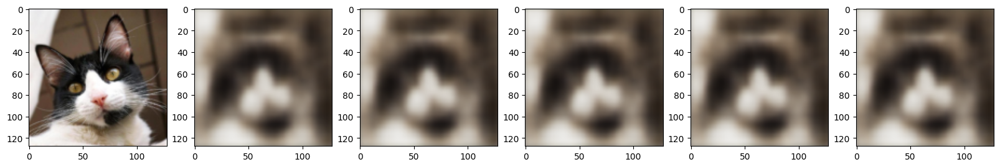

Epoch [3] - G : [-1.1581870317459106]
Epoch [4] Batch [40]  - [-0.03660748153924942]


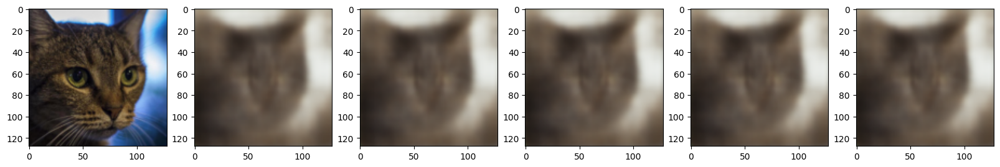

Epoch [4] - G : [-1.4876680374145508]
Epoch [5] Batch [40]  - [-0.038844965398311615]


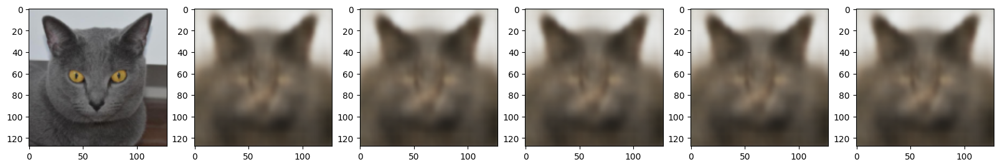

Epoch [5] - G : [-1.694625973701477]
Epoch [6] Batch [40]  - [-0.051112040877342224]


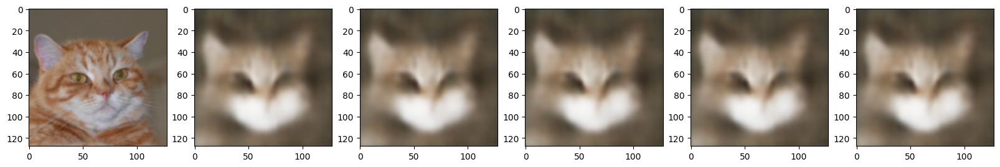

Epoch [6] - G : [-1.9346978664398193]
Epoch [7] Batch [40]  - [-0.06351564824581146]


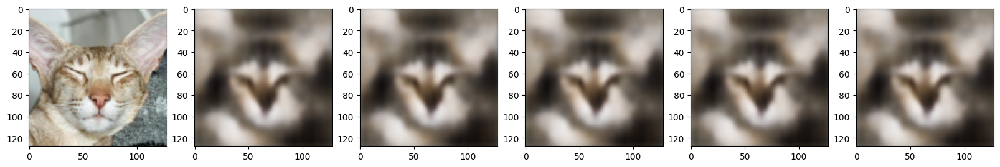

Epoch [7] - G : [-2.078946828842163]
Epoch [8] Batch [40]  - [-0.05794379115104675]


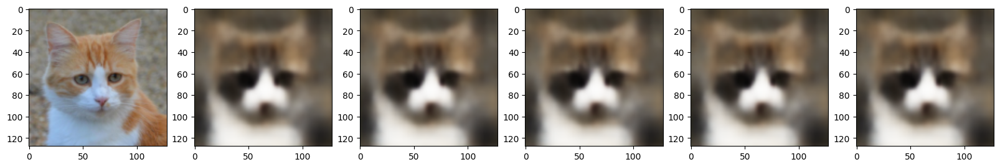

Epoch [8] - G : [-2.2849700450897217]
Epoch [9] Batch [40]  - [-0.06191294640302658]


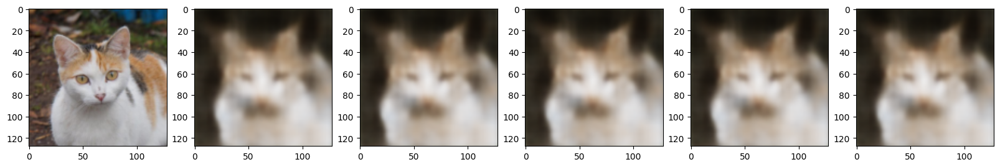

Epoch [9] - G : [-2.3912875652313232]
Epoch [10] Batch [40]  - [-0.06324751675128937]


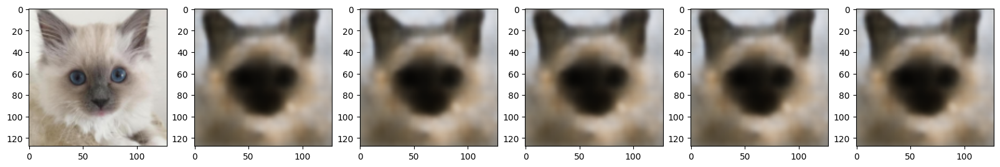

Epoch [10] - G : [-2.407261848449707]
Epoch [11] Batch [40]  - [-0.05123965069651604]


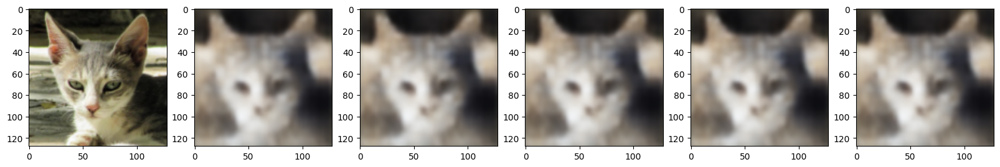

Epoch [11] - G : [-2.5265047550201416]
Epoch [12] Batch [40]  - [-0.06188347190618515]


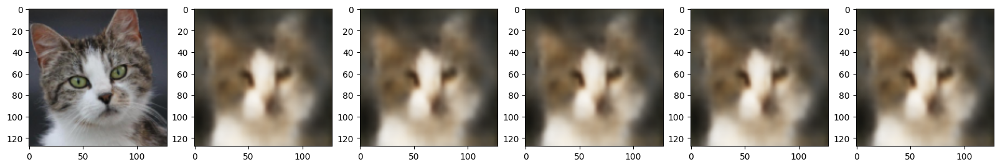

Epoch [12] - G : [-2.524413824081421]
Epoch [13] Batch [40]  - [-0.0683908686041832]


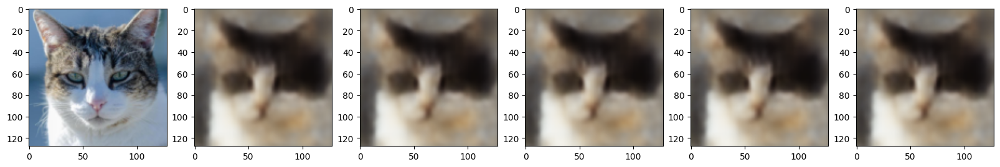

Epoch [13] - G : [-2.620211124420166]
Epoch [14] Batch [40]  - [-0.06659447401762009]


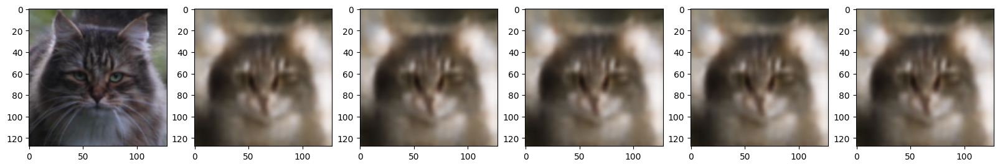

Epoch [14] - G : [-2.7402138710021973]
Epoch [15] Batch [40]  - [-0.06657879054546356]


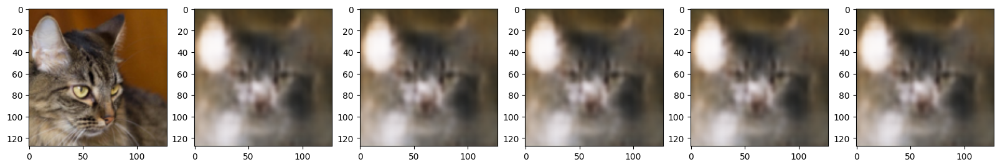

Epoch [15] - G : [-2.7242367267608643]
Epoch [16] Batch [40]  - [-0.06890426576137543]


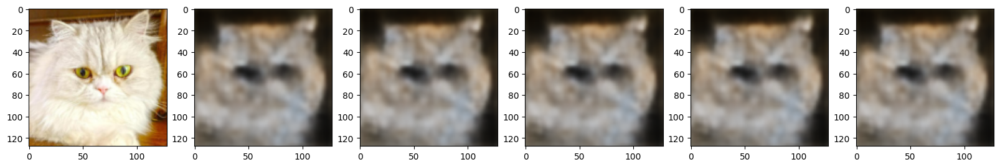

Epoch [16] - G : [-2.8483188152313232]
Epoch [17] Batch [40]  - [-0.06536827236413956]


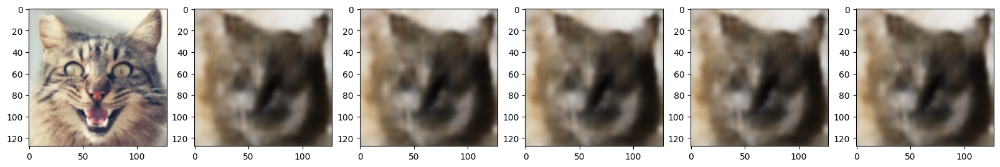

Epoch [17] - G : [-2.9693779945373535]
Epoch [18] Batch [40]  - [-0.045983653515577316]


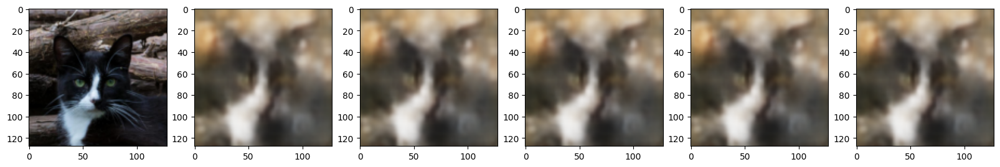

Epoch [18] - G : [-3.0004079341888428]
Epoch [19] Batch [40]  - [-0.07939069718122482]


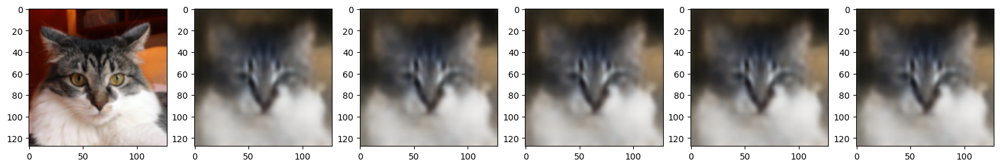

Epoch [19] - G : [-3.0812735557556152]
Epoch [20] Batch [40]  - [-0.07847030460834503]


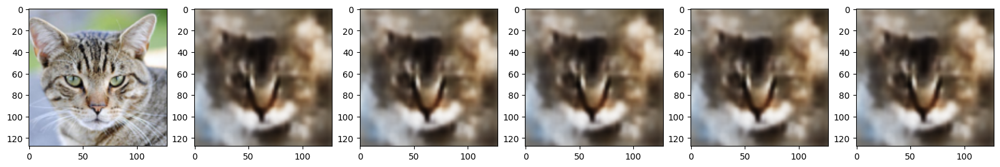

Epoch [20] - G : [-3.155832290649414]
Epoch [21] Batch [40]  - [-0.08267368376255035]


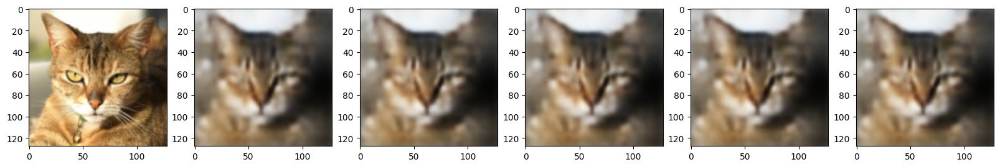

Epoch [21] - G : [-3.2060070037841797]
Epoch [22] Batch [40]  - [-0.07588649541139603]


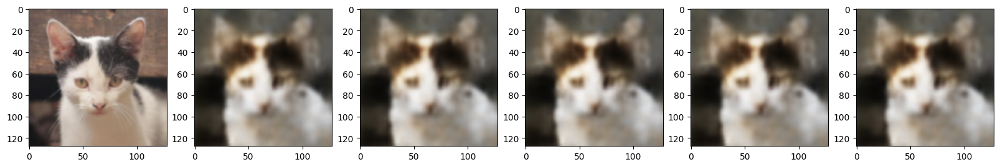

Epoch [22] - G : [-3.2622594833374023]
Epoch [23] Batch [40]  - [-0.07510299980640411]


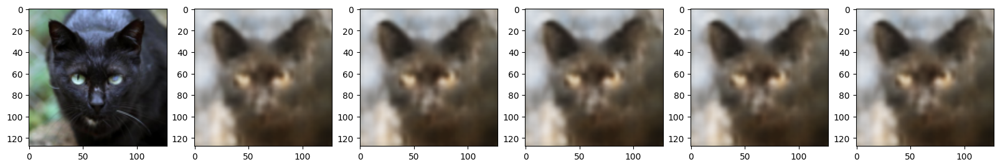

Epoch [23] - G : [-3.3172199726104736]
Epoch [24] Batch [40]  - [-0.07298453152179718]


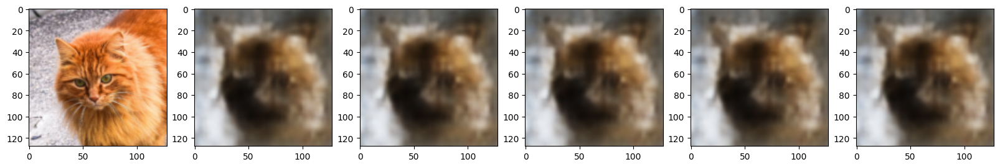

Epoch [24] - G : [-3.3579823970794678]
Epoch [25] Batch [40]  - [-0.08232857286930084]


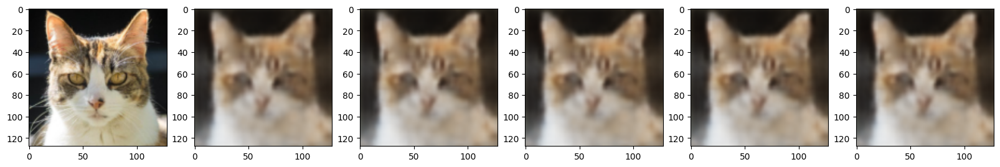

Epoch [25] - G : [-3.420482873916626]
Epoch [26] Batch [40]  - [-0.08506130427122116]


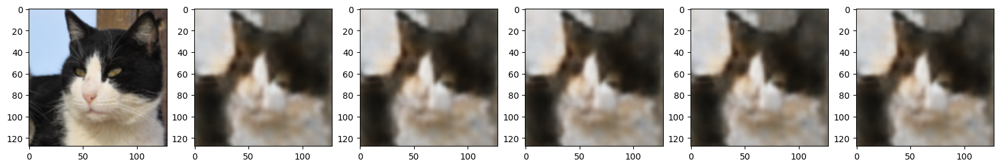

Epoch [26] - G : [-3.4438302516937256]
Epoch [27] Batch [40]  - [-0.07843886315822601]


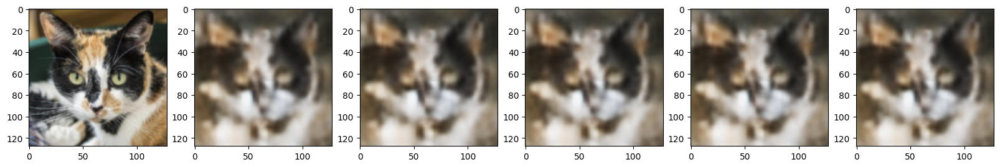

Epoch [27] - G : [-3.5019419193267822]
Epoch [28] Batch [40]  - [-0.08343220502138138]


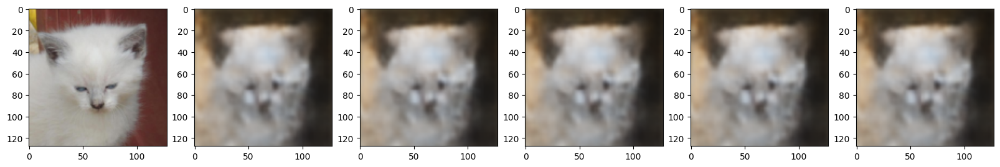

Epoch [28] - G : [-3.5989789962768555]
Epoch [29] Batch [40]  - [-0.08214050531387329]


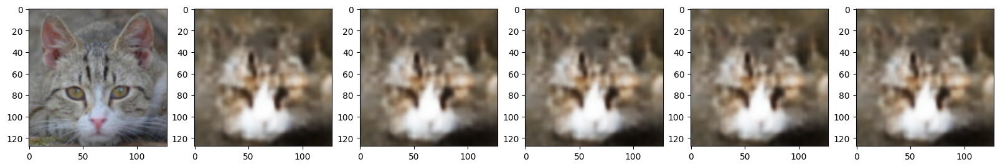

Epoch [29] - G : [-3.6299240589141846]
Epoch [30] Batch [40]  - [-0.08494800329208374]


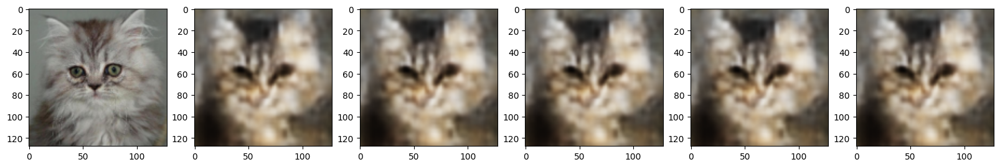

Epoch [30] - G : [-3.6666884422302246]
Epoch [31] Batch [40]  - [-0.08897272497415543]


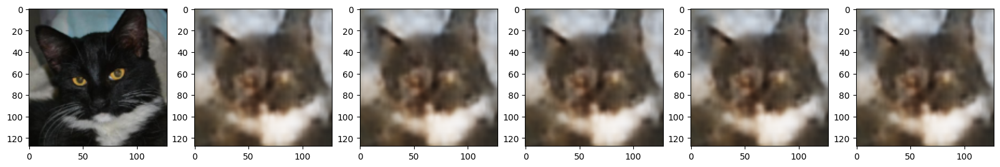

Epoch [31] - G : [-3.701455593109131]
Epoch [32] Batch [40]  - [-0.09121833741664886]


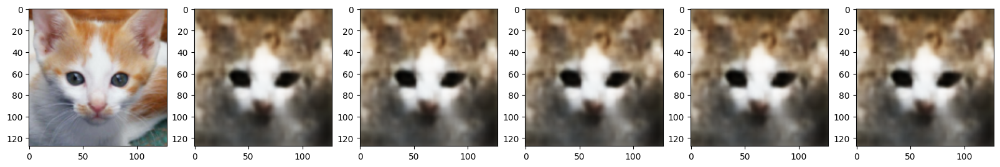

Epoch [32] - G : [-3.7934112548828125]
Epoch [33] Batch [40]  - [-0.0813417062163353]


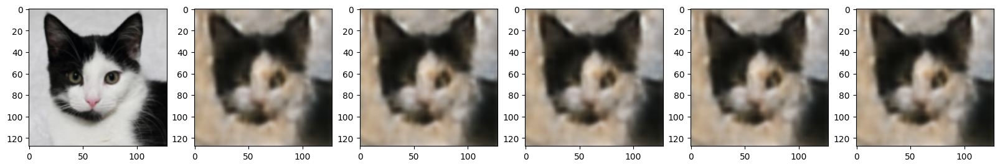

Epoch [33] - G : [-3.807137966156006]
Epoch [34] Batch [40]  - [-0.08710672706365585]


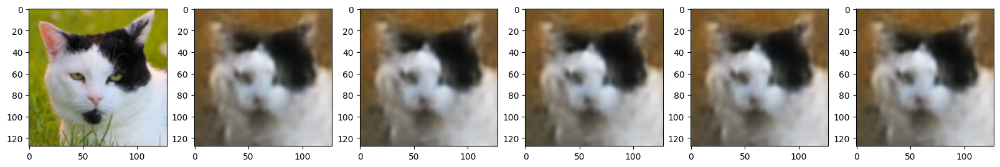

Epoch [34] - G : [-3.802384614944458]
Epoch [35] Batch [40]  - [-0.08889548480510712]


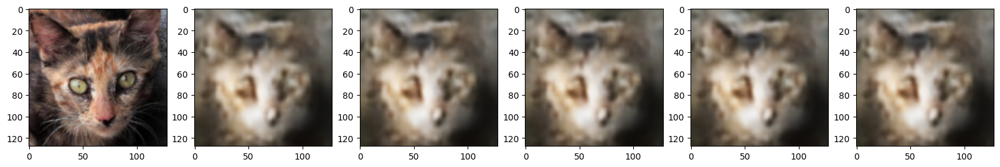

Epoch [35] - G : [-3.8796322345733643]
Epoch [36] Batch [40]  - [-0.09181316941976547]


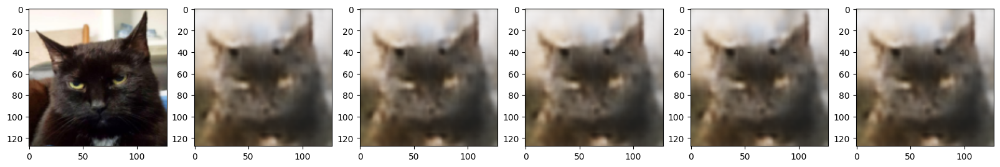

Epoch [36] - G : [-3.8919506072998047]
Epoch [37] Batch [40]  - [-0.09253929555416107]


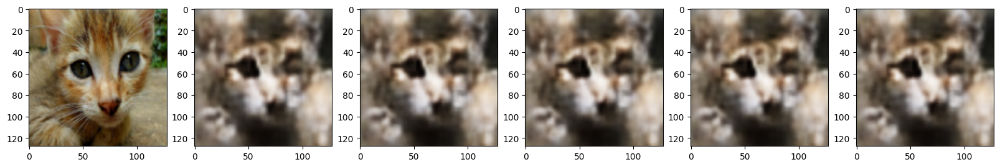

Epoch [37] - G : [-3.926847219467163]
Epoch [38] Batch [40]  - [-0.0866137146949768]


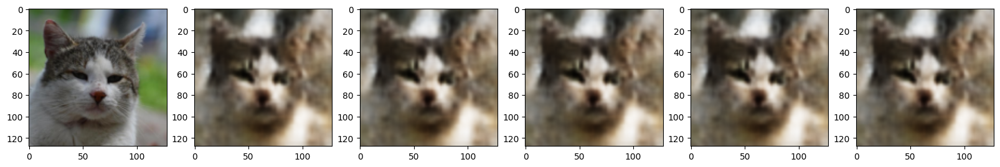

Epoch [38] - G : [-3.992655038833618]
Epoch [39] Batch [40]  - [-0.10087175667285919]


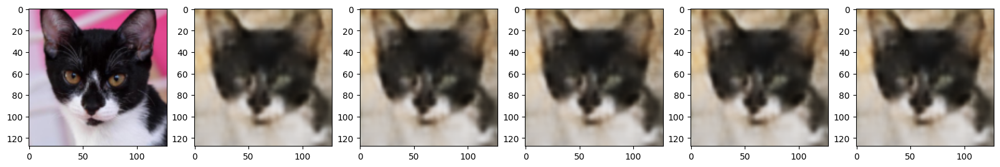

Epoch [39] - G : [-4.038638591766357]
Epoch [40] Batch [40]  - [-0.09377545118331909]


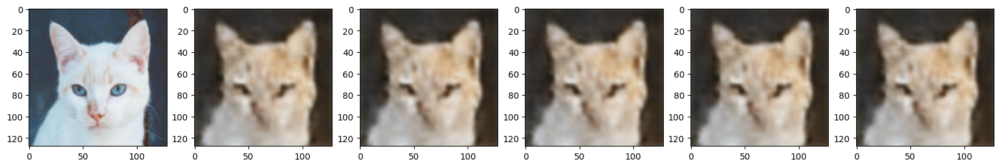

Epoch [40] - G : [-4.085165500640869]
Epoch [41] Batch [40]  - [-0.09763798862695694]


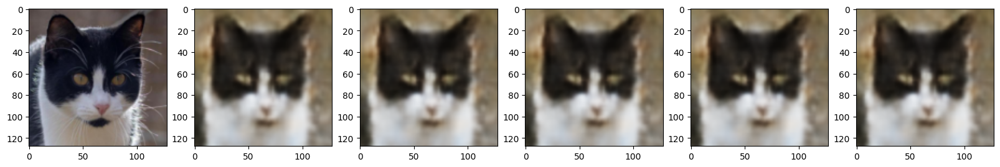

Epoch [41] - G : [-4.096567153930664]
Epoch [42] Batch [40]  - [-0.09525077044963837]


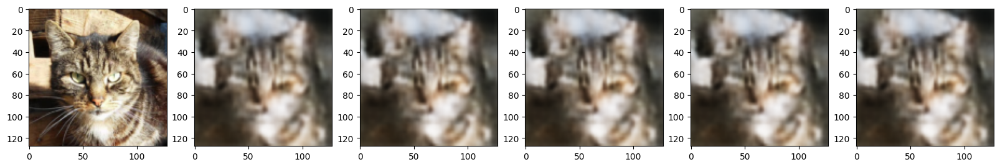

Epoch [42] - G : [-4.105005741119385]
Epoch [43] Batch [40]  - [-0.09884976595640182]


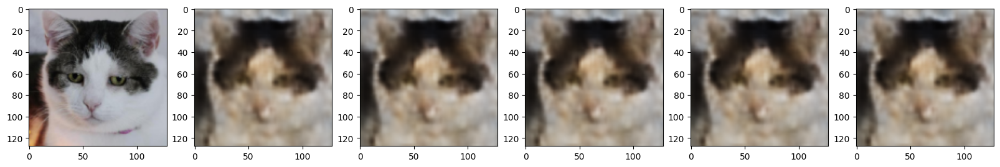

Epoch [43] - G : [-4.12335729598999]
Epoch [44] Batch [40]  - [-0.09281566739082336]


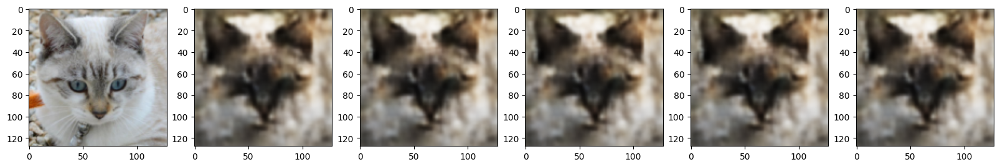

Epoch [44] - G : [-4.1742939949035645]
Epoch [45] Batch [40]  - [-0.0976141095161438]


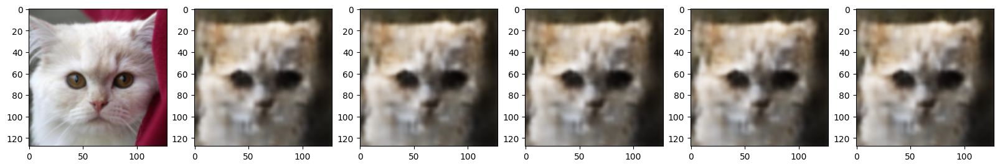

Epoch [45] - G : [-4.179589748382568]
Epoch [46] Batch [40]  - [-0.10745684802532196]


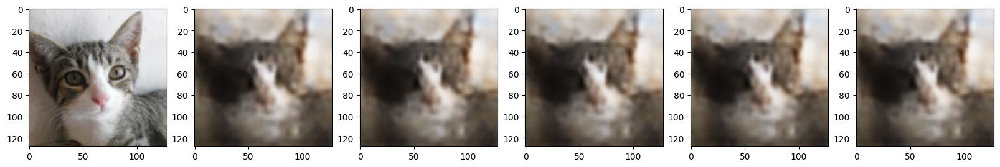

Epoch [46] - G : [-4.23820161819458]
Epoch [47] Batch [40]  - [-0.1045202985405922]


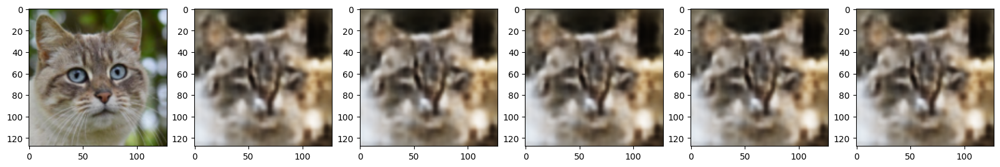

Epoch [47] - G : [-4.295377254486084]
Epoch [48] Batch [40]  - [-0.1040276288986206]


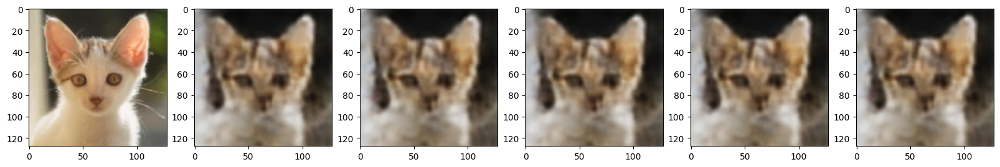

Epoch [48] - G : [-4.249504089355469]
Epoch [49] Batch [40]  - [-0.09732165932655334]


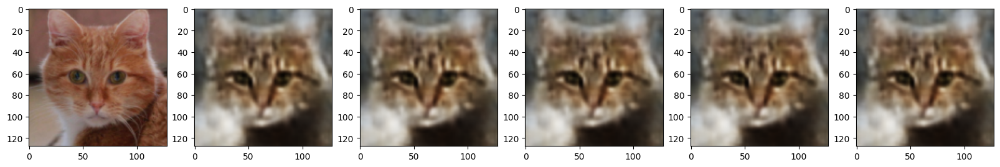

Epoch [49] - G : [-4.239670276641846]
Epoch [50] Batch [40]  - [-0.10595275461673737]


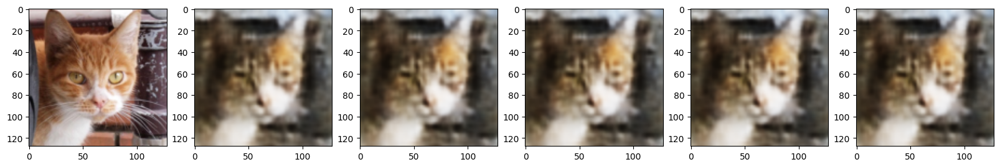

Epoch [50] - G : [-4.3114495277404785]
Epoch [51] Batch [40]  - [-0.10372331738471985]


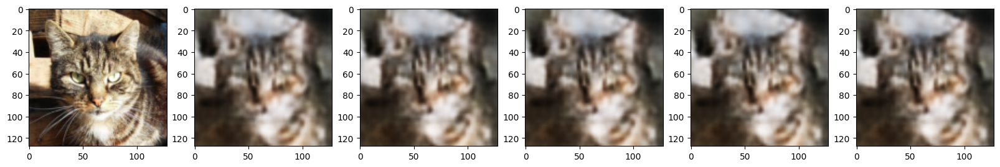

Epoch [51] - G : [-4.323515892028809]
Epoch [52] Batch [40]  - [-0.09971082955598831]


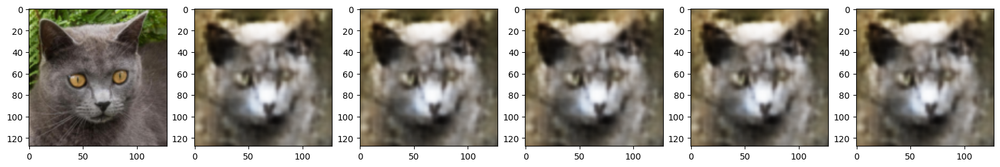

Epoch [52] - G : [-4.339057445526123]
Epoch [53] Batch [40]  - [-0.10317756980657578]


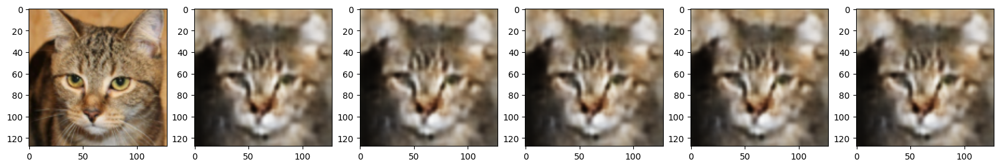

Epoch [53] - G : [-4.323423385620117]
Epoch [54] Batch [40]  - [-0.10872019082307816]


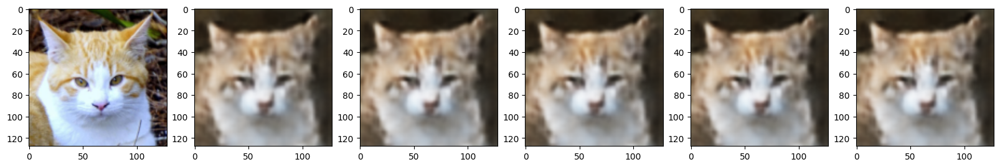

Epoch [54] - G : [-4.431025505065918]
Epoch [55] Batch [40]  - [-0.10338075459003448]


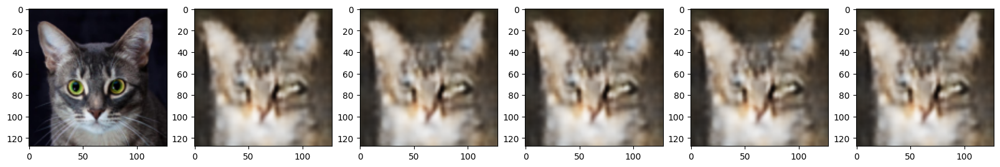

Epoch [55] - G : [-4.43208122253418]
Epoch [56] Batch [40]  - [-0.10802663117647171]


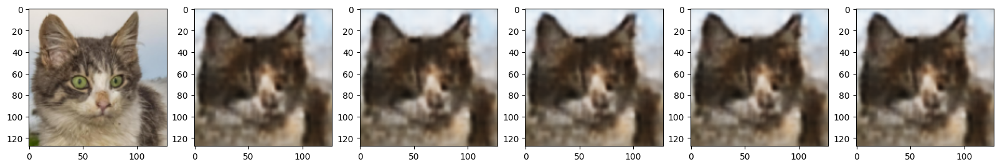

Epoch [56] - G : [-4.43392276763916]
Epoch [57] Batch [40]  - [-0.10397106409072876]


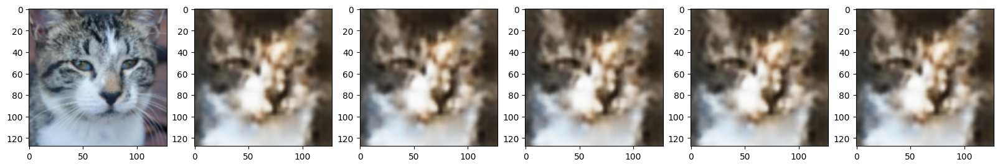

Epoch [57] - G : [-4.427497863769531]
Epoch [58] Batch [40]  - [-0.10443714261054993]


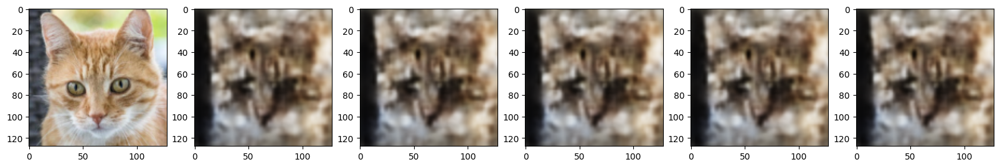

Epoch [58] - G : [-4.427375793457031]
Epoch [59] Batch [40]  - [-0.10519208759069443]


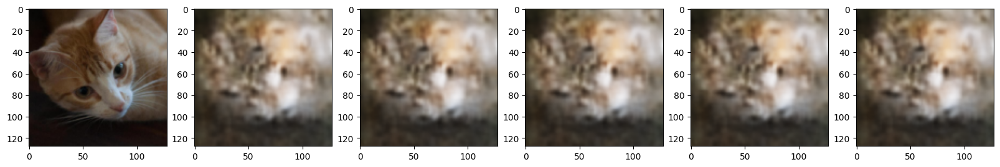

Epoch [59] - G : [-4.489858150482178]
Epoch [60] Batch [40]  - [-0.08999732881784439]


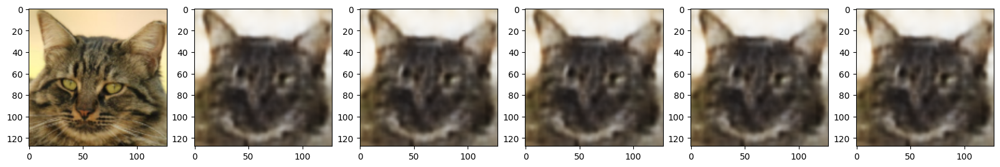

Epoch [60] - G : [-4.4765849113464355]
Epoch [61] Batch [40]  - [-0.11485909670591354]


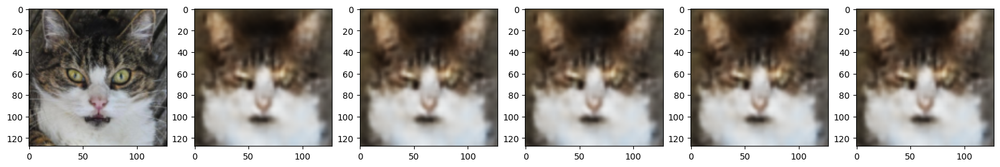

Epoch [61] - G : [-4.513073444366455]
Epoch [62] Batch [40]  - [-0.11026854813098907]


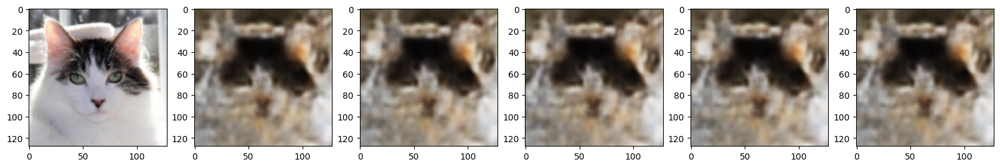

Epoch [62] - G : [-4.535064697265625]
Epoch [63] Batch [40]  - [-0.10557420551776886]


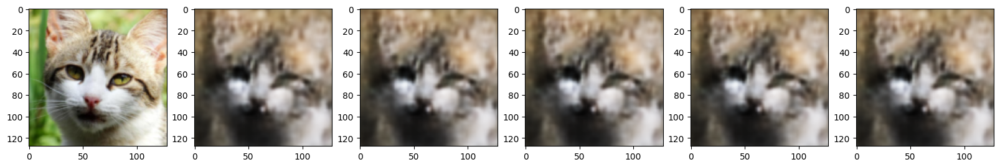

Epoch [63] - G : [-4.534785747528076]
Epoch [64] Batch [40]  - [-0.10665509849786758]


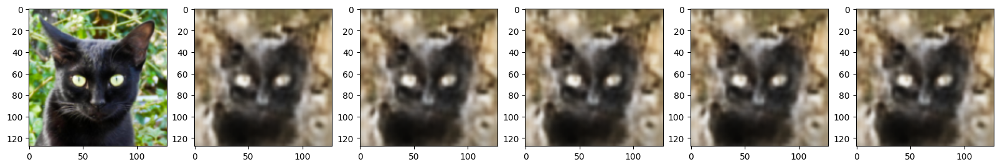

Epoch [64] - G : [-4.574828147888184]
Epoch [65] Batch [40]  - [-0.10819151997566223]


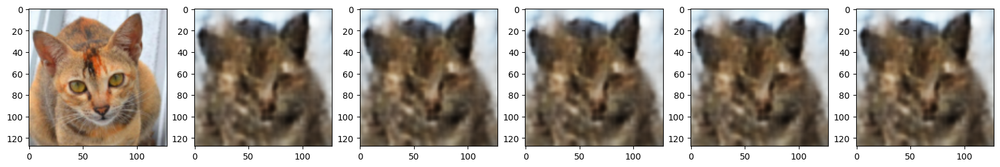

Epoch [65] - G : [-4.470740795135498]
Epoch [66] Batch [40]  - [-0.11056183278560638]


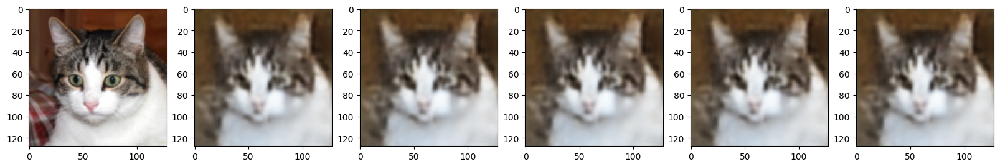

Epoch [66] - G : [-4.598587512969971]
Epoch [67] Batch [40]  - [-0.11328477412462234]


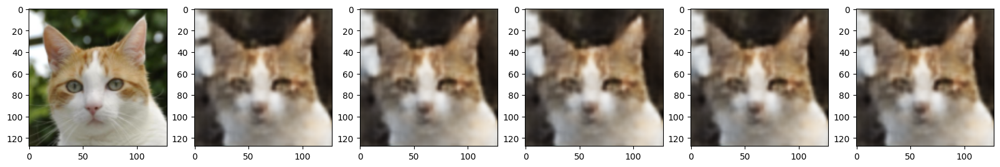

Epoch [67] - G : [-4.593337059020996]
Epoch [68] Batch [40]  - [-0.11471286416053772]


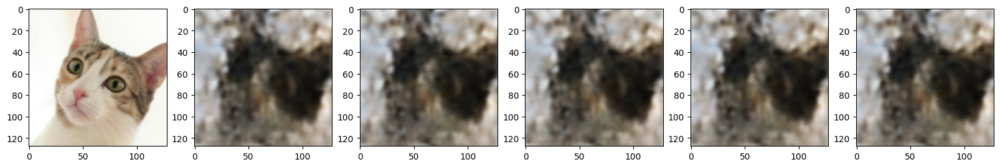

Epoch [68] - G : [-4.630525588989258]
Epoch [69] Batch [40]  - [-0.10946536064147949]


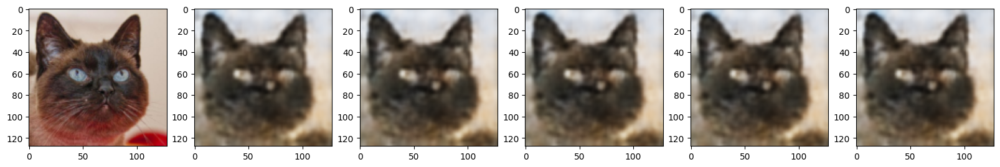

Epoch [69] - G : [-4.667942047119141]
Epoch [70] Batch [40]  - [-0.10911239683628082]


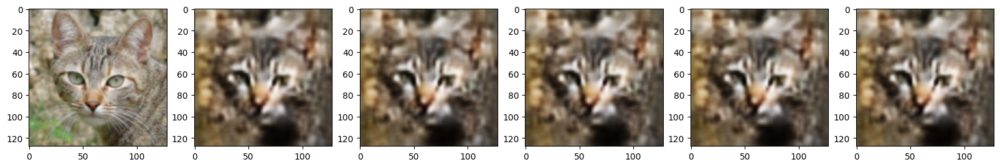

Epoch [70] - G : [-4.678677082061768]
Epoch [71] Batch [40]  - [-0.10236106812953949]


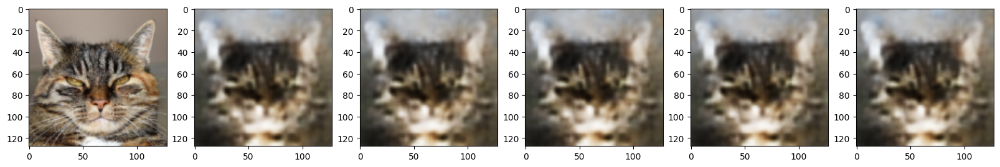

Epoch [71] - G : [-4.617522716522217]
Epoch [72] Batch [40]  - [-0.0982465073466301]


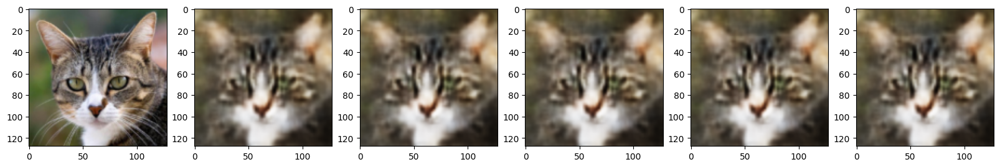

Epoch [72] - G : [-4.614766597747803]
Epoch [73] Batch [40]  - [-0.10864280164241791]


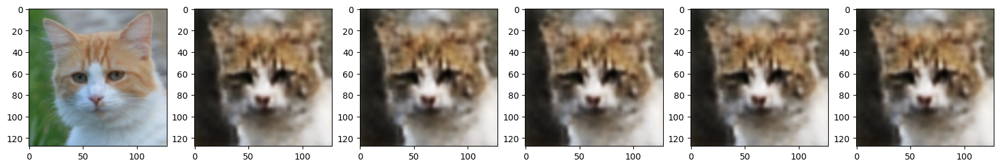

Epoch [73] - G : [-4.644183158874512]
Epoch [74] Batch [40]  - [-0.11241458356380463]


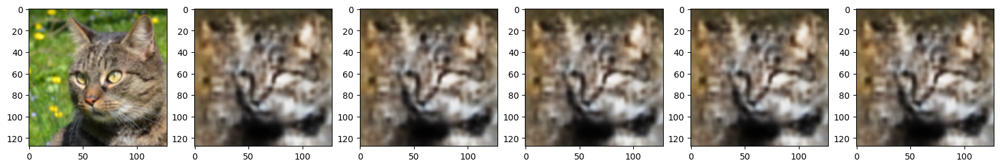

Epoch [74] - G : [-4.67165470123291]
Epoch [75] Batch [40]  - [-0.11326770484447479]


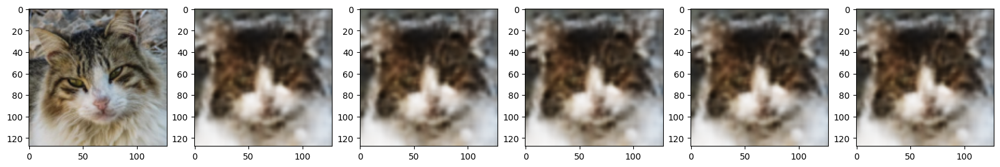

Epoch [75] - G : [-4.726306915283203]
Epoch [76] Batch [40]  - [-0.10673399269580841]


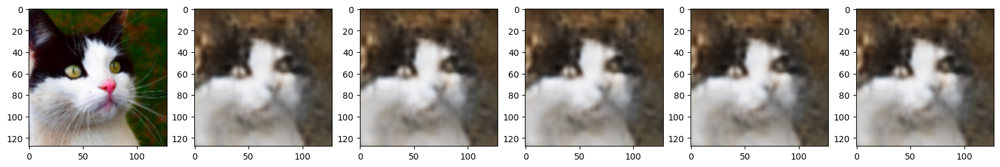

Epoch [76] - G : [-4.751522541046143]
Epoch [77] Batch [40]  - [-0.1102396547794342]


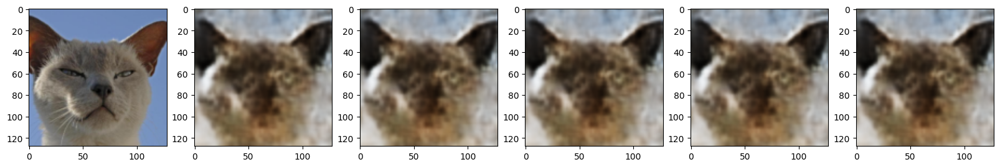

Epoch [77] - G : [-4.748426914215088]
Epoch [78] Batch [40]  - [-0.11718734353780746]


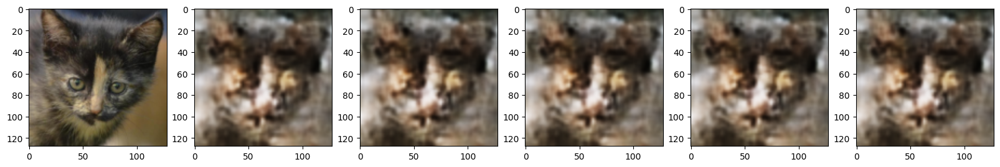

Epoch [78] - G : [-4.7630181312561035]
Epoch [79] Batch [40]  - [-0.11361154913902283]


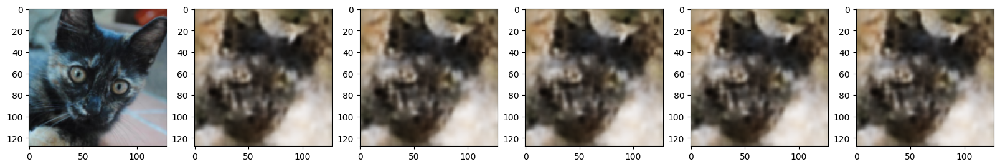

Epoch [79] - G : [-4.771705150604248]
Epoch [80] Batch [40]  - [-0.10729467123746872]


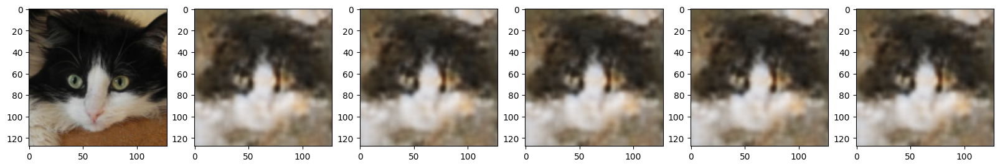

Epoch [80] - G : [-4.759992599487305]
Epoch [81] Batch [40]  - [-0.10852164030075073]


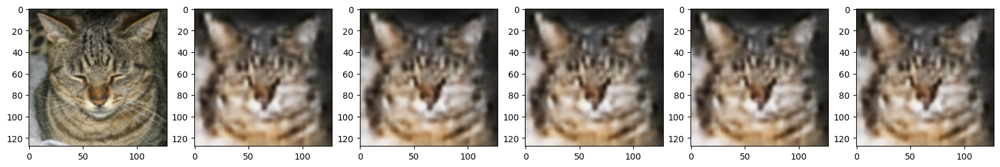

Epoch [81] - G : [-4.711615562438965]
Epoch [82] Batch [40]  - [-0.11301180720329285]


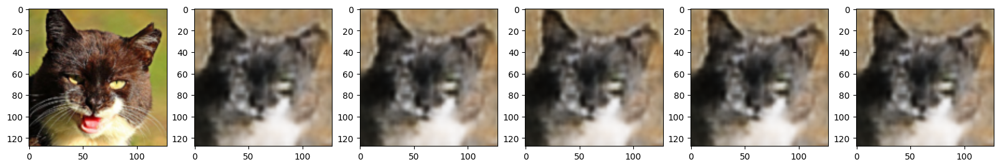

Epoch [82] - G : [-4.7563910484313965]
Epoch [83] Batch [40]  - [-0.11904580146074295]


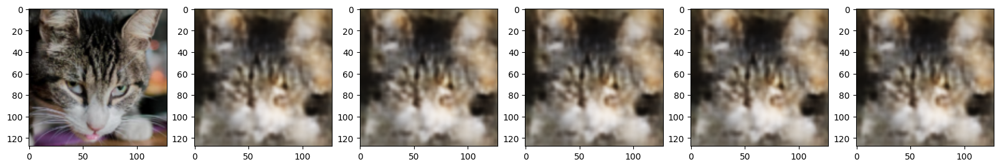

Epoch [83] - G : [-4.8471879959106445]
Epoch [84] Batch [40]  - [-0.11663676053285599]


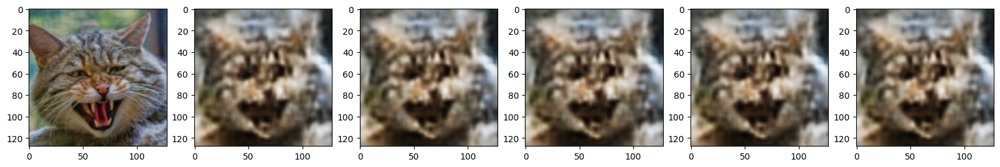

Epoch [84] - G : [-4.783742427825928]
Epoch [85] Batch [40]  - [-0.10739003866910934]


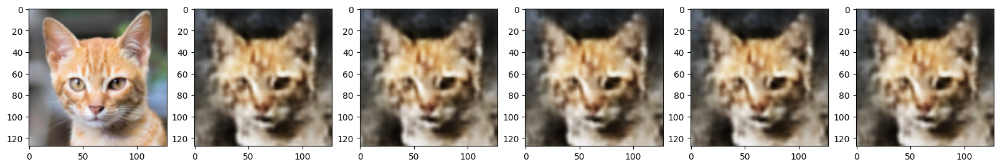

Epoch [85] - G : [-4.812735557556152]
Epoch [86] Batch [40]  - [-0.11315148323774338]


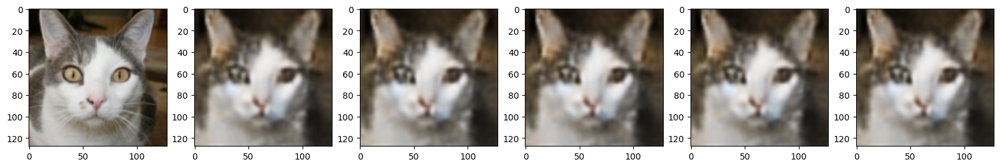

Epoch [86] - G : [-4.8235087394714355]
Epoch [87] Batch [40]  - [-0.11875949054956436]


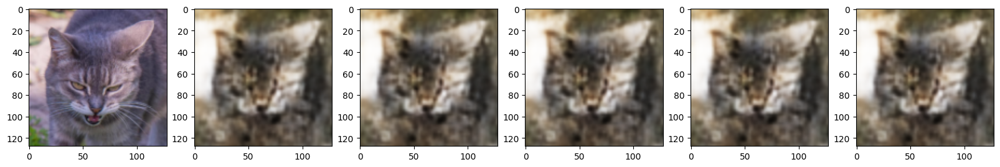

Epoch [87] - G : [-4.811099052429199]
Epoch [88] Batch [40]  - [-0.11416663974523544]


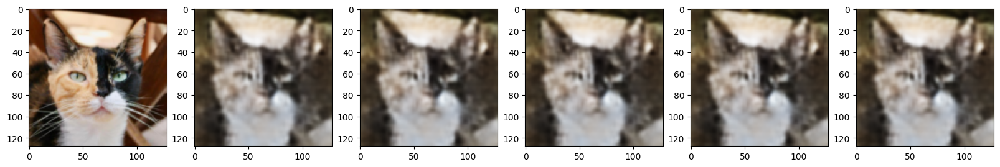

Epoch [88] - G : [-4.853728771209717]
Epoch [89] Batch [40]  - [-0.104926198720932]


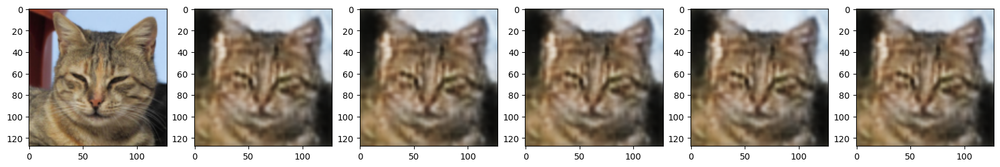

Epoch [89] - G : [-4.884978294372559]
Epoch [90] Batch [40]  - [-0.11950630694627762]


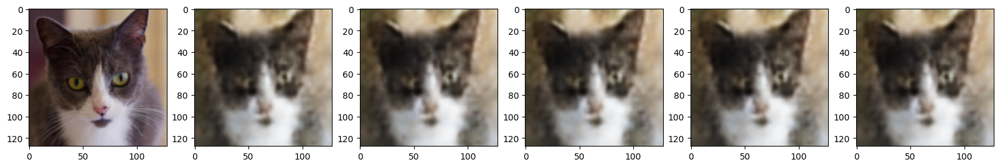

Epoch [90] - G : [-4.879428863525391]
Epoch [91] Batch [40]  - [-0.10917079448699951]


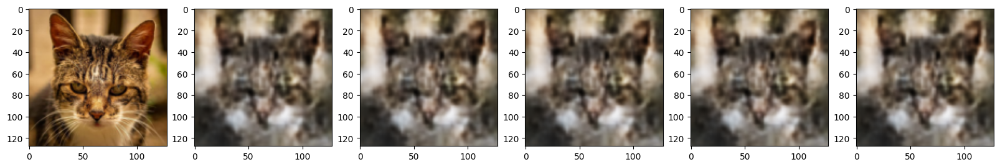

Epoch [91] - G : [-4.847343921661377]
Epoch [92] Batch [40]  - [-0.10608284920454025]


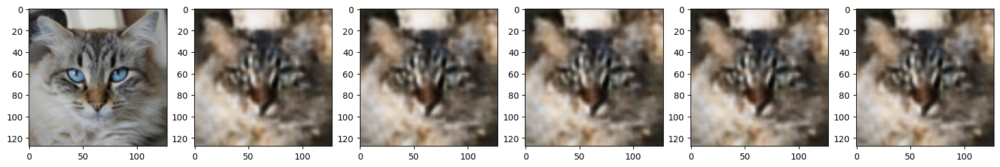

Epoch [92] - G : [-4.780069828033447]
Epoch [93] Batch [40]  - [-0.11983609944581985]


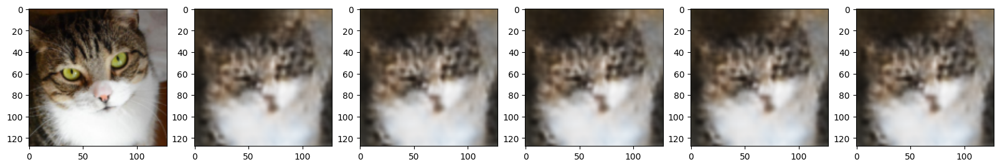

Epoch [93] - G : [-4.874510765075684]
Epoch [94] Batch [40]  - [-0.11198823899030685]


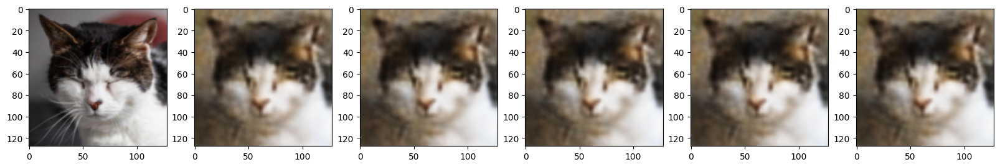

Epoch [94] - G : [-4.860525608062744]
Epoch [95] Batch [40]  - [-0.11898881942033768]


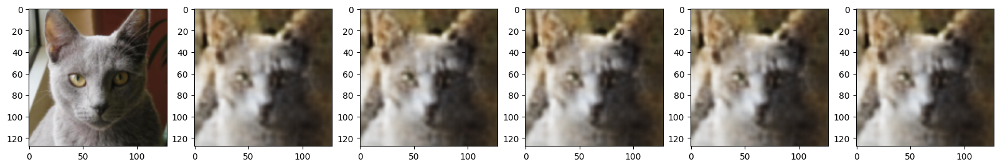

Epoch [95] - G : [-4.83790397644043]
Epoch [96] Batch [40]  - [-0.11740615218877792]


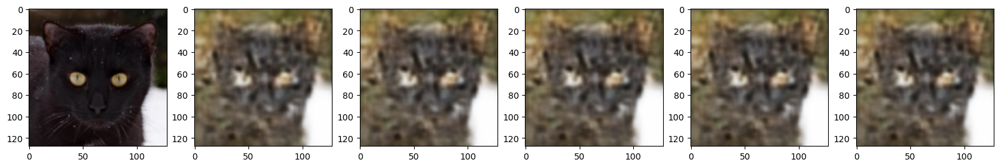

Epoch [96] - G : [-4.9146246910095215]
Epoch [97] Batch [40]  - [-0.12228331714868546]


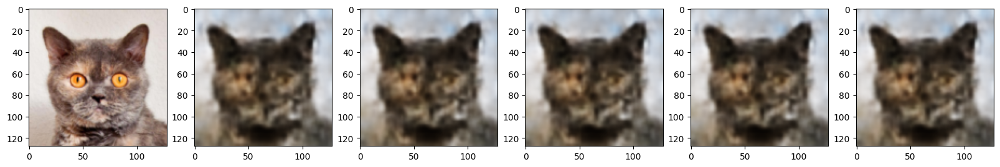

Epoch [97] - G : [-4.929678440093994]
Epoch [98] Batch [40]  - [-0.12212837487459183]


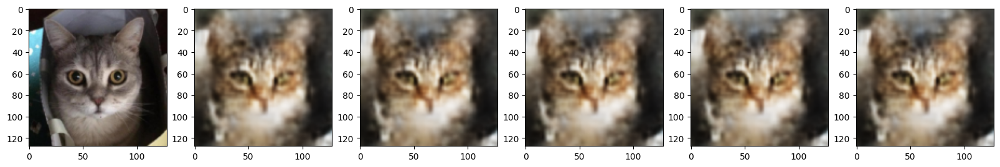

Epoch [98] - G : [-4.918054580688477]
Epoch [99] Batch [40]  - [-0.11628032475709915]


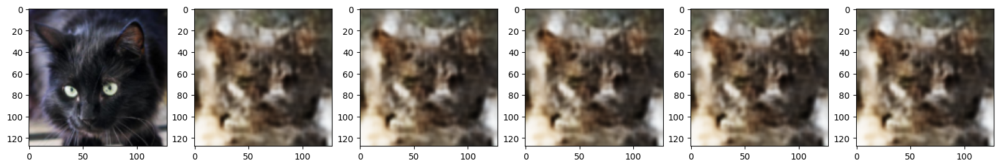

Epoch [99] - G : [-4.971949100494385]
Epoch [100] Batch [40]  - [-0.12265748530626297]


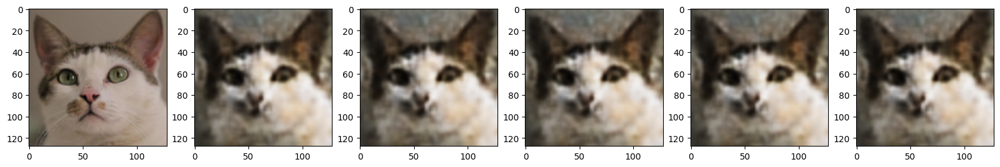

Epoch [100] - G : [-4.926901817321777]
Epoch [101] Batch [40]  - [-0.11738599091768265]


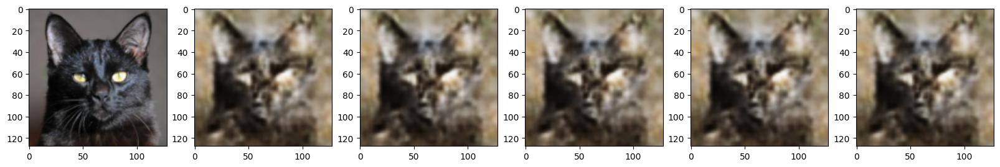

Epoch [101] - G : [-4.9525885581970215]
Epoch [102] Batch [40]  - [-0.11874072253704071]


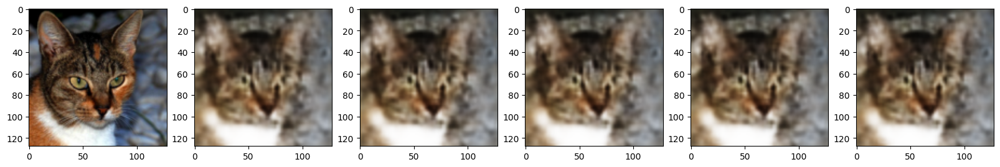

Epoch [102] - G : [-4.933553218841553]
Epoch [103] Batch [40]  - [-0.1087745726108551]


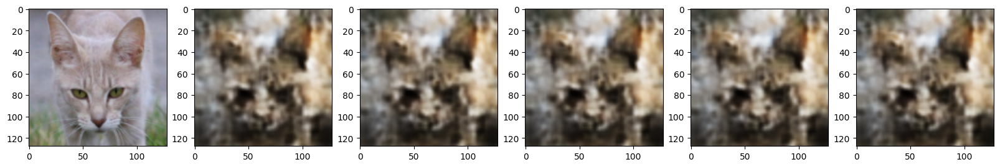

Epoch [103] - G : [-4.938354969024658]
Epoch [104] Batch [40]  - [-0.12055763602256775]


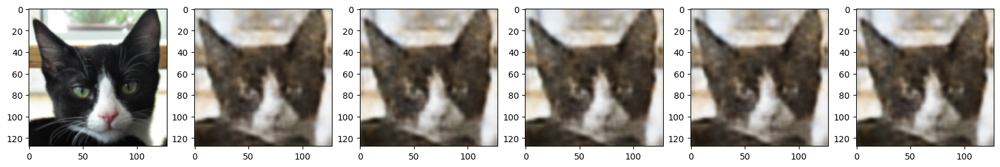

Epoch [104] - G : [-4.954496383666992]
Epoch [105] Batch [40]  - [-0.1150406152009964]


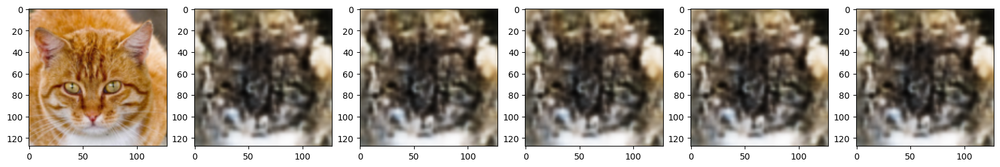

Epoch [105] - G : [-4.8934102058410645]
Epoch [106] Batch [40]  - [-0.1192912608385086]


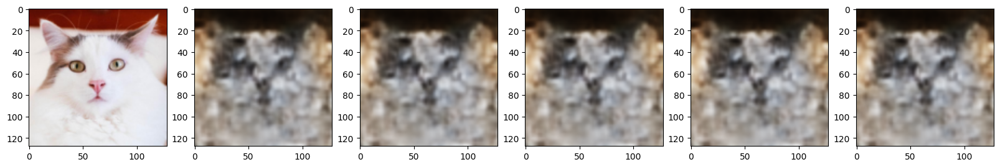

Epoch [106] - G : [-4.884105682373047]
Epoch [107] Batch [40]  - [-0.11399421840906143]


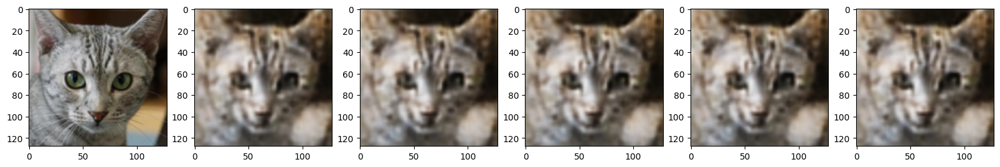

Epoch [107] - G : [-4.878352642059326]
Epoch [108] Batch [40]  - [-0.12590262293815613]


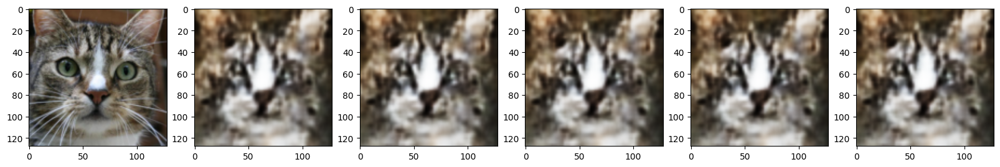

Epoch [108] - G : [-4.990609169006348]
Epoch [109] Batch [40]  - [-0.11542540788650513]


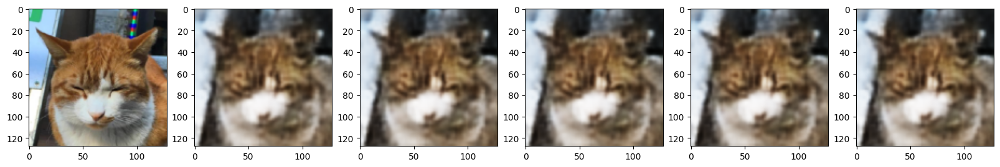

Epoch [109] - G : [-4.989986419677734]
Epoch [110] Batch [40]  - [-0.116481252014637]


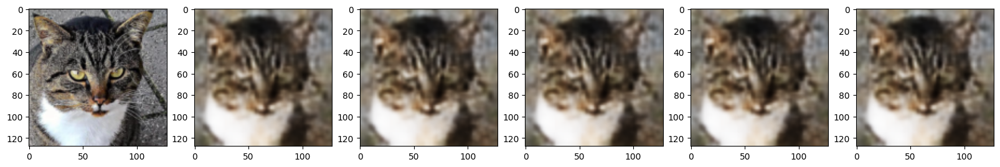

Epoch [110] - G : [-4.99881649017334]
Epoch [111] Batch [40]  - [-0.11942654103040695]


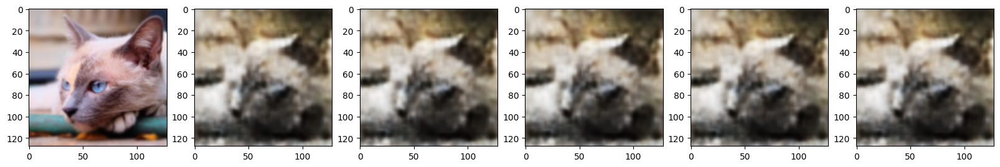

Epoch [111] - G : [-5.0022664070129395]
Epoch [112] Batch [40]  - [-0.11127012223005295]


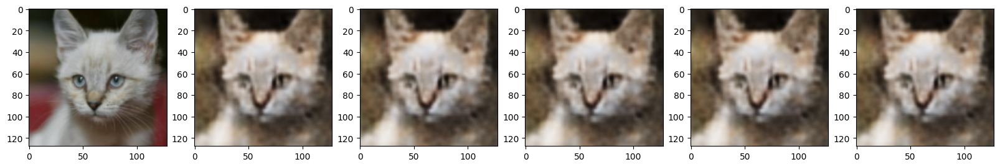

Epoch [112] - G : [-5.0084404945373535]
Epoch [113] Batch [40]  - [-0.12310503423213959]


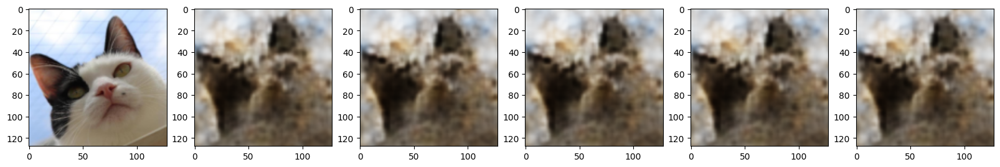

Epoch [113] - G : [-4.9751129150390625]
Epoch [114] Batch [40]  - [-0.12158286571502686]


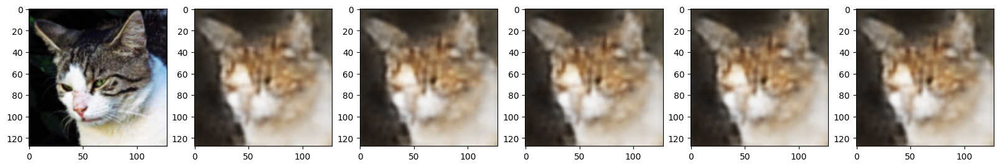

Epoch [114] - G : [-4.977801322937012]
Epoch [115] Batch [40]  - [-0.12021081894636154]


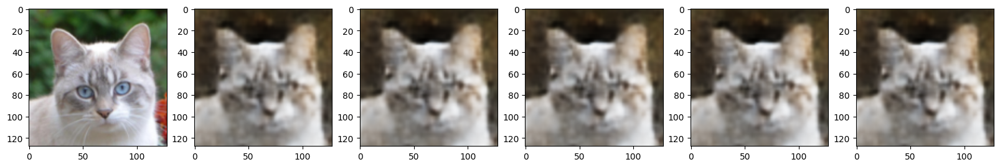

Epoch [115] - G : [-5.015102863311768]


In [ ]:
optimizerG = torch.optim.Adam(g.parameters(), lr=LR)
optimizerE = torch.optim.Adam(en.parameters(), lr=LR)

generator_loss = torch.nn.MSELoss().to(device)
ls = torch.nn.MSELoss().to(device)

counter = 0
for e in range(150):
    
    G_loss = 0


    for bi,(x,_) in enumerate(iter(X_train_loader)):
        
        counter+=1
        
        x = x.to(device)

        # Train discriminator 
        optimizerG.zero_grad()
        optimizerE.zero_grad()
        
        fake_z = torch.randn(len(x),Z_DIM, device=device)
        
        e_res = en(x)
        g_res = g(e_res[0],e_res[1],fake_z)
        kl_loss = sum(e_res[0]**2 + e_res[1]**2 - torch.log(e_res[1]+0.0001) - 1/2)
        ssm_loss = - ssim( (g_res+1)*255.0/2.0,(x+1)*255.0/2.0, data_range=255, size_average=True)
        loss = 0.2*ssm_loss+ 0.8*generator_loss(g_res,x)
        loss.backward()
        optimizerG.step()
        optimizerE.step()
              
#             print("Training Generator")

        with torch.no_grad():
            G_loss += loss
        
        
            if(bi != 0 and bi % 40 == 0):
                print(f"Epoch [{e}] Batch [{bi}]  - [{loss.item()}]")

                with torch.no_grad():
                    for ii,x_e in enumerate(e_res):
                        x_e = e_res[:,ii,:]
                        fig,axs=plt.subplots(1,6,figsize=(20,10))
                        axs[0].imshow(((x[ii].cpu()+1.0)*255.0/2.0).permute(1,2,0).int())
                        for r in range(5):
                            if r != 0 :
                                noise = torch.randn(Z_DIM, device=device)
                            else:
                                noise = torch.zeros(Z_DIM, device=device)

                            g_res = g(x_e[0].view(1,-1),x_e[1].view(1,-1),noise.view(1,-1))
                            axs[r+1].imshow(((g_res[0].cpu()+1.0)*255.0/2.0).permute(1,2,0).int())
                        plt.show()
                        break
    print(f"Epoch [{e}] - G : [{G_loss.item()}]")

# Visualising Data